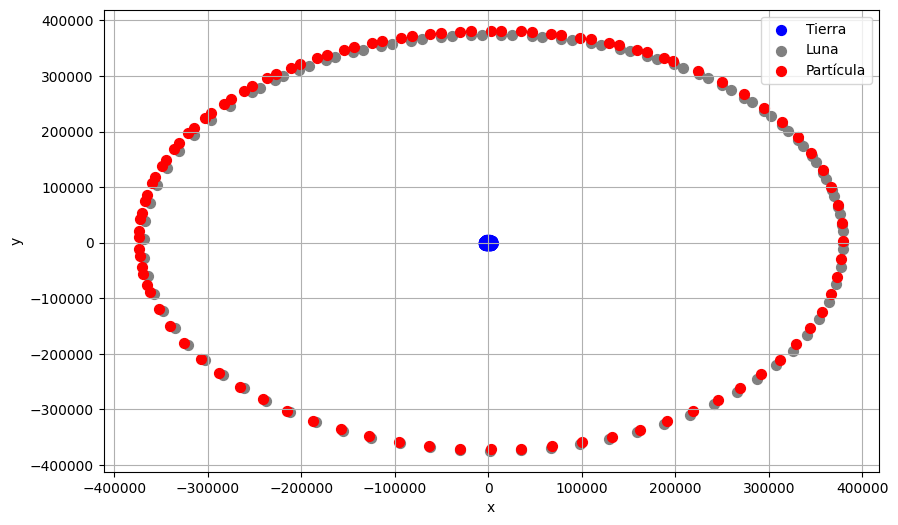

In [3]:
# Estabilidad punto L4

!pip install Rebound
import rebound
import matplotlib.pyplot as plt
import numpy as np

# Función para la posición de la Luna
def pos_luna(r,theta):
  x = r*np.cos(theta)
  y = r*np.sin(theta)
  return (x,y)

# Función para la posición de la partícula en L4
def pos_particula4(r,theta):
  x = r*np.cos((np.pi/3) + theta)
  y = r*np.sin((np.pi/3) + theta)
  return (x,y)

# Constantes del sistema
masa_luna = 7.349e22
theta = 0
G = 6.63e-5 # Constante G en (km**3/kg * yr**2)
masa_tierra = 5.97217e24

r_luna = 3.844e5 # Distancia Tierra-Luna en km
r_particula4 = r_luna

# Posiciones iniciales
x_luna,y_luna = pos_luna(r_luna,theta)
x_particula4,y_particula4 = pos_particula4(r_particula4,theta)

# Velocidades iniciales
vx_luna,vy_luna = (0,np.sqrt((G*masa_tierra)/r_luna))
vx_part4,vy_part4 = (vx_luna * np.cos(np.pi/3) - vy_luna * np.sin(np.pi/3),  vy_luna * np.cos(np.pi/3) + vx_luna * np.sin(np.pi/3)) #Rotación vector

# Crear simulación en REBOUND
sim = rebound.Simulation()
sim.units=('km','yr','kg')
sim.integrator = 'ias15'
sim.dt = 0.001
sim.add(m = masa_tierra)
sim.add(m = masa_luna, x = x_luna, y = y_luna, vx = vx_luna, vy = vy_luna)
sim.add(x = x_particula4, y = y_particula4, vx = vx_part4, vy = vy_part4)
#sim.add(x = x_particula5, y = y_particula5, vx = vx_part5, vy = vx_part5)
sim.move_to_com()

# Resolución y tiempo de la simulación
resolution = 100
x_pos = np.empty((3,resolution))
y_pos = np.empty((3,resolution))
z_pos = np.empty((3,resolution))
times = np.linspace(0,0.1,num = resolution)

# Almacenar posiciones a lo largo del tiempo
for i,t in enumerate(times):
  sim.integrate(t)
  x_pos[0,i] = sim.particles[0].x
  y_pos[0,i] = sim.particles[0].y
  x_pos[1,i] = sim.particles[1].x
  y_pos[1,i] = sim.particles[1].y
  x_pos[2,i] = sim.particles[2].x
  y_pos[2,i] = sim.particles[2].y

# Graficar la simulación
plt.figure(figsize=(10, 6))
plt.scatter(x_pos[0], y_pos[0], color='blue', label='Tierra', s=50)
plt.scatter(x_pos[1], y_pos[1], color='gray', label='Luna', s=50)
plt.scatter(x_pos[2], y_pos[2], color='red', label='Partícula', s=50)

plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.grid(True)

plt.show()

<ipython-input-4-fcb709d03e1b>:96: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  tierra.set_data(x_pos[0, frame], y_pos[0, frame])
<ipython-input-4-fcb709d03e1b>:97: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  luna.set_data(x_pos[1, frame], y_pos[1, frame])
<ipython-input-4-fcb709d03e1b>:98: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  particula.set_data(x_pos[2, frame], y_pos[2, frame])


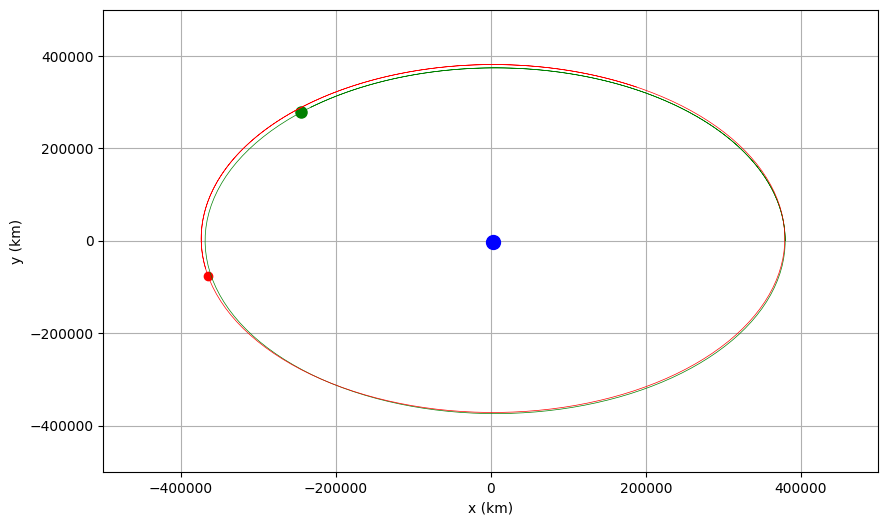

In [4]:
# Animación estabilidad punto L4

!pip install rebound
import rebound
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Función para la posición de la Luna
def pos_luna(r, theta):
    x = r * np.cos(theta)
    y = r * np.sin(theta)
    return (x, y)

# Función para la posición de la partícula en L4
def pos_particula4(r, theta):
    x = r * np.cos((np.pi / 3) + theta)
    y = r * np.sin((np.pi / 3) + theta)
    return (x, y)

# Constantes del sistema
masa_luna = 7.349e22
theta = 0
G = 6.63e-5  # Constante G en (km**3/kg * yr**2)
masa_tierra = 5.97217e24

r_luna = 3.844e5  # Distancia Tierra-Luna en km
r_particula4 = r_luna

# Posiciones iniciales
x_luna, y_luna = pos_luna(r_luna, theta)
x_particula4, y_particula4 = pos_particula4(r_particula4, theta)

# Velocidades iniciales
vx_luna, vy_luna = (0, np.sqrt((G * masa_tierra) / r_luna))
vx_part4, vy_part4 = (
    vx_luna * np.cos(np.pi / 3) - vy_luna * np.sin(np.pi / 3),
    vy_luna * np.cos(np.pi / 3) + vx_luna * np.sin(np.pi / 3),
)

# Crear la simulación con REBOUND
sim = rebound.Simulation()
sim.units = ('km', 'yr', 'kg')
sim.integrator = 'ias15'
sim.dt = 0.001
sim.add(m=masa_tierra)  # Tierra
sim.add(m=masa_luna, x=x_luna, y=y_luna, vx=vx_luna, vy=vy_luna)  # Luna
sim.add(x=x_particula4, y=y_particula4, vx=vx_part4, vy=vy_part4)  # Partícula en L4
sim.move_to_com()

# Resolución y tiempo de la simulación
resolution = 200
x_pos = np.empty((3, resolution))
y_pos = np.empty((3, resolution))
times = np.linspace(0, 0.1, num=resolution)

# Almacenar posiciones a lo largo del tiempo
for i, t in enumerate(times):
    sim.integrate(t)
    x_pos[0, i] = sim.particles[0].x
    y_pos[0, i] = sim.particles[0].y
    x_pos[1, i] = sim.particles[1].x
    y_pos[1, i] = sim.particles[1].y
    x_pos[2, i] = sim.particles[2].x
    y_pos[2, i] = sim.particles[2].y

# Crear la figura y los objetos de la animación
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(-5e5, 5e5)
ax.set_ylim(-5e5, 5e5)
ax.set_xlabel('x (km)')
ax.set_ylabel('y (km)')
ax.grid(True)

# Crear objetos de animación
tierra, = ax.plot([], [], 'bo', label='Tierra', ms=10)
luna, = ax.plot([], [], 'go', label='Luna', ms=8)
particula, = ax.plot([], [], 'ro', label='Partícula L4', ms=6)
trayectoria_tierra, = ax.plot([], [], 'b-', lw=0.5)
trayectoria_luna, = ax.plot([], [], 'g-', lw=0.5)
trayectoria_particula, = ax.plot([], [], 'r-', lw=0.5)

# Inicializar la animación
def init():
    tierra.set_data([], [])
    luna.set_data([], [])
    particula.set_data([], [])
    trayectoria_tierra.set_data([], [])
    trayectoria_luna.set_data([], [])
    trayectoria_particula.set_data([], [])
    return tierra, luna, particula, trayectoria_tierra, trayectoria_luna, trayectoria_particula

# Actualizar la animación en cada cuadro
def update(frame):
    tierra.set_data(x_pos[0, frame], y_pos[0, frame])
    luna.set_data(x_pos[1, frame], y_pos[1, frame])
    particula.set_data(x_pos[2, frame], y_pos[2, frame])

    trayectoria_tierra.set_data(x_pos[0, :frame], y_pos[0, :frame])
    trayectoria_luna.set_data(x_pos[1, :frame], y_pos[1, :frame])
    trayectoria_particula.set_data(x_pos[2, :frame], y_pos[2, :frame])

    return tierra, luna, particula, trayectoria_tierra, trayectoria_luna, trayectoria_particula

# Crear la animación
ani = FuncAnimation(fig, update, frames=resolution, init_func=init, blit=True, interval=30)

# Mostrar la animación en Colab
HTML(ani.to_jshtml())


<ipython-input-5-9e9af1793211>:125: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  tierra.set_data(x_pos[0, frame], y_pos[0, frame])
<ipython-input-5-9e9af1793211>:126: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  luna.set_data(x_pos[1, frame], y_pos[1, frame])
<ipython-input-5-9e9af1793211>:127: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  particula4.set_data(x_pos[2, frame], y_pos[2, frame])
<ipython-input-5-9e9af1793211>:128: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  particula5.set_data(x_pos[3, frame], y_pos[3, frame])
<ipython-input-5-9e9af1793211>:129: MatplotlibDeprecationWarning: Setting data with a non sequence

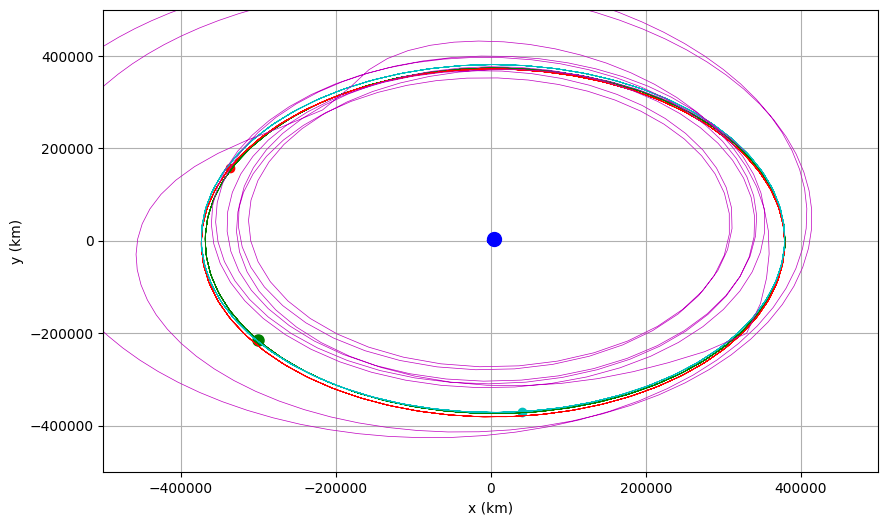

In [5]:
# Estabilidad L4 y L5 más una partícula en órbita inestable

!pip install rebound
import rebound
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Función para la posición de la Luna
def pos_luna(r, theta):
    x = r * np.cos(theta)
    y = r * np.sin(theta)
    return (x, y)

# Función para la posición de la partícula en Lagrange
def pos_particula_lagrange(r, theta, shift):
    x = r * np.cos(shift + theta)
    y = r * np.sin(shift + theta)
    return (x, y)

# Constantes del sistema
masa_luna = 7.349e22
theta = 0
G = 6.63e-5  # Constante G en (km**3/kg * yr**2)
masa_tierra = 5.97217e24

r_luna = 3.844e5  # Distancia Tierra-Luna en km
r_particula4 = r_luna

# Posiciones iniciales
x_luna, y_luna = pos_luna(r_luna, theta)
x_particula4, y_particula4 = pos_particula_lagrange(r_particula4, theta, -np.pi / 3)
x_particula5, y_particula5 = pos_particula_lagrange(r_particula4, theta, np.pi / 3)
x_particula_random, y_particula_random = pos_particula_lagrange(r_particula4, theta, np.pi / 6)


# Velocidades iniciales
vx_luna, vy_luna = (0, np.sqrt((G * masa_tierra) / r_luna))
vx_part4, vy_part4 = (
    vx_luna * np.cos(-np.pi / 3) - vy_luna * np.sin(-np.pi / 3),
    vy_luna * np.cos(-np.pi / 3) + vx_luna * np.sin(-np.pi / 3),
)
vx_part5, vy_part5 = (
    vx_luna * np.cos(np.pi / 3) - vy_luna * np.sin(np.pi / 3),
    vy_luna * np.cos(np.pi / 3) + vx_luna * np.sin(np.pi / 3),
)
vx_part_random, vy_part_random = (
    vx_luna * np.cos(np.pi / 6) - vy_luna * np.sin(np.pi / 6),
    vy_luna * np.cos(np.pi / 6) + vx_luna * np.sin(np.pi / 6),
)

# Crear la simulación con REBOUND
sim = rebound.Simulation()
sim.units = ('km', 'yr', 'kg')
sim.integrator = 'ias15'
sim.dt = 0.001
sim.add(m=masa_tierra)  # Tierra
sim.add(m=masa_luna, x=x_luna, y=y_luna, vx=vx_luna, vy=vy_luna)  # Luna
sim.add(x=x_particula4, y=y_particula4, vx=vx_part4, vy=vy_part4)  # Partícula en L4
sim.add(x=x_particula5, y=y_particula5, vx=vx_part5, vy=vy_part5)  # Partícula en L5
sim.add(x=x_particula_random, y=y_particula_random, vx=vx_part_random, vy=vy_part_random)  # Partícula aleatoria
sim.move_to_com()

# Resolución y tiempo de la simulación
resolution = 500
x_pos = np.empty((5, resolution))  # Ampliamos para 5 cuerpos
y_pos = np.empty((5, resolution))
times = np.linspace(0, 0.2 * np.pi, resolution)

# Almacenar posiciones a lo largo del tiempo
for i, t in enumerate(times):
    sim.integrate(t)
    x_pos[0, i] = sim.particles[0].x  # Tierra
    y_pos[0, i] = sim.particles[0].y
    x_pos[1, i] = sim.particles[1].x  # Luna
    y_pos[1, i] = sim.particles[1].y
    x_pos[2, i] = sim.particles[2].x  # Partícula L4
    y_pos[2, i] = sim.particles[2].y
    x_pos[3, i] = sim.particles[3].x  # Partícula L5
    y_pos[3, i] = sim.particles[3].y
    x_pos[4, i] = sim.particles[4].x  # Partícula aleatoria 1
    y_pos[4, i] = sim.particles[4].y


# Crear la figura y los objetos de la animación
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(-5e5, 5e5)
ax.set_ylim(-5e5, 5e5)
ax.set_xlabel('x (km)')
ax.set_ylabel('y (km)')
ax.grid(True)

# Crear objetos de animación
tierra, = ax.plot([], [], 'bo', label='Tierra', ms=10)
luna, = ax.plot([], [], 'go', label='Luna', ms=8)
particula4, = ax.plot([], [], 'ro', label='Partícula L4', ms=6)
particula5, = ax.plot([], [], 'co', label='Partícula L5', ms=6)
particula_random, = ax.plot([], [], 'mo', label='Partícula Aleatoria', ms=6)

trayectoria_tierra, = ax.plot([], [], 'b-', lw=0.5)
trayectoria_luna, = ax.plot([], [], 'g-', lw=0.5)
trayectoria_particula4, = ax.plot([], [], 'r-', lw=0.5)
trayectoria_particula5, = ax.plot([], [], 'c-', lw=0.5)
trayectoria_particula_random, = ax.plot([], [], 'm-', lw=0.5)

# Inicializar la animación
def init():
    tierra.set_data([], [])
    luna.set_data([], [])
    particula4.set_data([], [])
    particula5.set_data([], [])
    particula_random.set_data([], [])

    trayectoria_tierra.set_data([], [])
    trayectoria_luna.set_data([], [])
    trayectoria_particula4.set_data([], [])
    trayectoria_particula5.set_data([], [])
    trayectoria_particula_random.set_data([], [])

    return tierra, luna, particula4, particula5, particula_random, trayectoria_tierra, trayectoria_luna, trayectoria_particula4, trayectoria_particula5, trayectoria_particula_random

# Actualizar la animación en cada cuadro
def update(frame):
    tierra.set_data(x_pos[0, frame], y_pos[0, frame])
    luna.set_data(x_pos[1, frame], y_pos[1, frame])
    particula4.set_data(x_pos[2, frame], y_pos[2, frame])
    particula5.set_data(x_pos[3, frame], y_pos[3, frame])
    particula_random.set_data(x_pos[4, frame], y_pos[4, frame])

    trayectoria_tierra.set_data(x_pos[0, :frame], y_pos[0, :frame])
    trayectoria_luna.set_data(x_pos[1, :frame], y_pos[1, :frame])
    trayectoria_particula4.set_data(x_pos[2, :frame], y_pos[2, :frame])
    trayectoria_particula5.set_data(x_pos[3, :frame], y_pos[3, :frame])
    trayectoria_particula_random.set_data(x_pos[4, :frame], y_pos[4, :frame])

    return tierra, luna, particula4, particula5, particula_random, trayectoria_tierra, trayectoria_luna, trayectoria_particula4, trayectoria_particula5, trayectoria_particula_random

# Crear la animación
ani = FuncAnimation(fig, update, frames=resolution, init_func=init, blit=True, interval=30)

# Mostrar la animación en Colab
HTML(ani.to_jshtml())

<ipython-input-6-7b15d4c5ab79>:95: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  tierra.set_data(x_pos[0, frame], y_pos[0, frame])
<ipython-input-6-7b15d4c5ab79>:96: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  luna.set_data(x_pos[1, frame], y_pos[1, frame])
<ipython-input-6-7b15d4c5ab79>:97: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  particula.set_data(x_pos[2, frame], y_pos[2, frame])


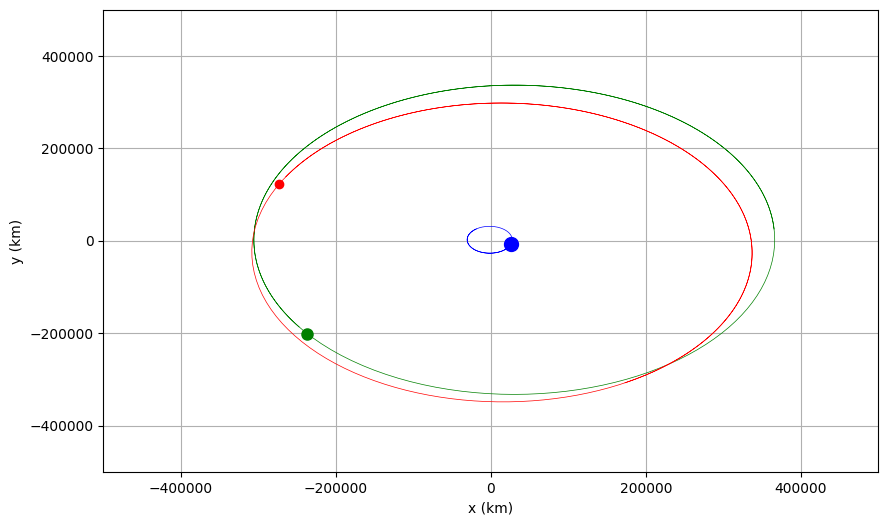

In [6]:
# Creamos la misma simulación pero colocamos la partícula en L5 y le damos masa
!pip install rebound
import rebound
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Función para la posición de la Luna
def pos_luna(r, theta):
    x = r * np.cos(theta)
    y = r * np.sin(theta)
    return (x, y)

# Función para la posición de la partícula en L5
def pos_particula4(r, theta):
    x = r * np.cos(-(np.pi / 3) + theta)
    y = r * np.sin(-(np.pi / 3) + theta)
    return (x, y)

# Constantes del sistema
masa_luna = 7.349e22
theta = 0
G = 6.63e-5  # Constante G en (km**3/kg * yr**2)
masa_tierra = 5.97217e24

r_luna = 3.844e5  # Distancia Tierra-Luna en km
r_particula4 = r_luna

# Posiciones iniciales
x_luna, y_luna = pos_luna(r_luna, theta)
x_particula4, y_particula4 = pos_particula4(r_particula4, theta)

# Velocidades iniciales
vx_luna, vy_luna = (0, np.sqrt((G * masa_tierra) / r_luna))
vx_part4, vy_part4 = (
    vx_luna * np.cos(-np.pi / 3) - vy_luna * np.sin(-np.pi / 3),
    vy_luna * np.cos(-np.pi / 3) + vx_luna * np.sin(-np.pi / 3),
)

# Crear la simulación con REBOUND
sim = rebound.Simulation()
sim.units = ('km', 'yr', 'kg')
sim.integrator = 'ias15'
sim.dt = 0.001
sim.add(m=masa_tierra)  # Tierra
sim.add(m=masa_luna, x=x_luna, y=y_luna, vx=vx_luna, vy=vy_luna)  # Luna
sim.add(m=5e23,x=x_particula4, y=y_particula4, vx=vx_part4, vy=vy_part4)  # Partícula en L5, con una masa de magnitud e23
sim.move_to_com()

# Resolución y tiempo de la simulación
resolution = 200
x_pos = np.empty((3, resolution))
y_pos = np.empty((3, resolution))
times = np.linspace(0, 0.1, num=resolution)

# Almacenar posiciones a lo largo del tiempo
for i, t in enumerate(times):
    sim.integrate(t)
    x_pos[0, i] = sim.particles[0].x
    y_pos[0, i] = sim.particles[0].y
    x_pos[1, i] = sim.particles[1].x
    y_pos[1, i] = sim.particles[1].y
    x_pos[2, i] = sim.particles[2].x
    y_pos[2, i] = sim.particles[2].y

# Crear la figura y los objetos de la animación
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_xlim(-5e5, 5e5)
ax.set_ylim(-5e5, 5e5)
ax.set_xlabel('x (km)')
ax.set_ylabel('y (km)')
ax.grid(True)

# Crear objetos de animación
tierra, = ax.plot([], [], 'bo', label='Tierra', ms=10)
luna, = ax.plot([], [], 'go', label='Luna', ms=8)
particula, = ax.plot([], [], 'ro', label='Partícula L4', ms=6)
trayectoria_tierra, = ax.plot([], [], 'b-', lw=0.5)
trayectoria_luna, = ax.plot([], [], 'g-', lw=0.5)
trayectoria_particula, = ax.plot([], [], 'r-', lw=0.5)

# Inicializar la animación
def init():
    tierra.set_data([], [])
    luna.set_data([], [])
    particula.set_data([], [])
    trayectoria_tierra.set_data([], [])
    trayectoria_luna.set_data([], [])
    trayectoria_particula.set_data([], [])
    return tierra, luna, particula, trayectoria_tierra, trayectoria_luna, trayectoria_particula

# Actualizar la animación en cada cuadro
def update(frame):
    tierra.set_data(x_pos[0, frame], y_pos[0, frame])
    luna.set_data(x_pos[1, frame], y_pos[1, frame])
    particula.set_data(x_pos[2, frame], y_pos[2, frame])

    trayectoria_tierra.set_data(x_pos[0, :frame], y_pos[0, :frame])
    trayectoria_luna.set_data(x_pos[1, :frame], y_pos[1, :frame])
    trayectoria_particula.set_data(x_pos[2, :frame], y_pos[2, :frame])

    return tierra, luna, particula, trayectoria_tierra, trayectoria_luna, trayectoria_particula

# Crear la animación
ani = FuncAnimation(fig, update, frames=resolution, init_func=init, blit=True, interval=30)

# Mostrar la animación en Colab
HTML(ani.to_jshtml())

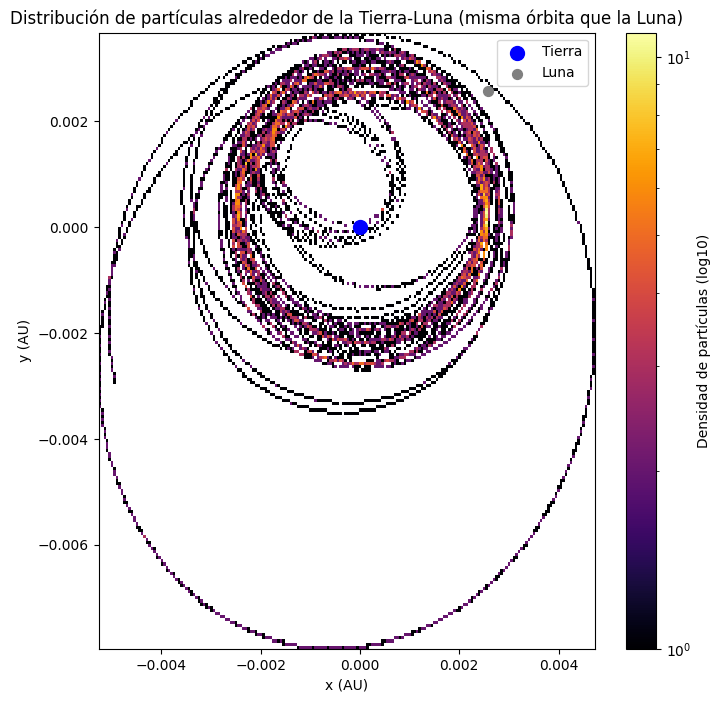

In [7]:
#Distribución de partículas alrededor del sistema Tierra-Luna

!pip install rebound
import rebound
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LogNorm

# Función para la posición de las partículas en una órbita circular
def pos_particula_orbita(r, theta):
    x = r * np.cos(theta)
    y = r * np.sin(theta)
    return (x, y)

# Constantes del sistema
masa_luna = 7.349e22
theta = 0
G = 6.63e-5  # Constante G en (km**3/kg * yr**2)
masa_tierra = 5.97217e24

r_luna = 3.844e5  # Distancia Tierra-Luna en km

# Velocidades iniciales para la Luna
vx_luna, vy_luna = (0, np.sqrt((G * masa_tierra) / r_luna))

# Crear la simulación con REBOUND
sim = rebound.Simulation()
sim.units = ('km', 'yr', 'kg')
sim.integrator = 'ias15'
sim.dt = 0.0000001
sim.add(m=masa_tierra)  # Tierra
sim.add(m=masa_luna, x=r_luna, y=0, vx=0, vy=vy_luna)  # Luna

# Añadir partículas en la misma órbita que la Luna
num_particulas = 10  # Número de partículas
for i in range(num_particulas):
    # Distribuir las partículas en diferentes ángulos alrededor de la Tierra
    theta_particula = np.random.uniform(0, 2 * np.pi)
    x_part, y_part = pos_particula_orbita(r_luna, theta_particula)

    # Velocidades iniciales para las partículas (órbita circular)
    vx_part = -np.sqrt((G * masa_tierra) / r_luna) * np.sin(theta_particula)
    vy_part = np.sqrt((G * masa_tierra) / r_luna) * np.cos(theta_particula)

    sim.add(x=x_part, y=y_part, vx=vx_part, vy=vy_part)



# Ahora, calculamos el número total de partículas simuladas
num_particulas_totales = sim.N - 2  # Restamos 2 porque no contamos Tierra y Luna

# Resolución de la simulación y almacenamiento de posiciones
resolution = 1000
positions = np.empty((num_particulas_totales, 2, resolution))  # Guardar todas las posiciones
times = np.linspace(0, 0.1*np.pi, resolution)

# Almacenar posiciones de las partículas y la Luna a lo largo del tiempo
x_tierra, y_tierra = [], []
x_luna, y_luna = [], []
for i, t in enumerate(times):
    sim.integrate(t)
    # Guardar posiciones de la Tierra (en el origen)
    x_tierra.append(sim.particles[0].x)
    y_tierra.append(sim.particles[0].y)

    # Guardar posiciones de la Luna
    x_luna.append(sim.particles[1].x)
    y_luna.append(sim.particles[1].y)

    # Guardar posiciones de las partículas
    for j in range(2, sim.N):  # Ignorar Tierra y Luna (índices 0 y 1)
        positions[j-2, 0, i] = sim.particles[j].x
        positions[j-2, 1, i] = sim.particles[j].y

# Ahora que tenemos las posiciones, vamos a crear un gráfico de densidad con escala logarítmica
x_data = positions[:, 0, :].flatten() / 1.496e8  # Convertir km a AU (1 AU = 1.496e8 km)
y_data = positions[:, 1, :].flatten() / 1.496e8
sim.move_to_com()
# Crear gráfico de densidad (histograma en 2D)
plt.figure(figsize=(8,8))
plt.hist2d(x_data, y_data, bins=200, cmap='inferno', norm=LogNorm())  # Usar LogNorm para escala logarítmica
plt.colorbar(label='Densidad de partículas (log10)')

# Añadir posiciones de la Tierra (en el centro del sistema)
plt.scatter(0, 0, color='blue', s=100, label='Tierra')

# Añadir posiciones de la Luna (promediando todas las posiciones)
plt.scatter((r_luna)/1.496e8, (r_luna)/1.496e8, color='gray', s=50, label='Luna')

plt.title('Distribución de partículas alrededor de la Tierra-Luna (misma órbita que la Luna)')
plt.xlabel('x (AU)')
plt.ylabel('y (AU)')
plt.legend()
plt.grid(False)
plt.show()